# Final Project: ADV TOPICS ARTIFICIAL INTELLIG CS 5660 

## Artwork Mapped Using ML

Our project aims to create an interactive 3D map of thousands of artworks, clustering them based on visual similarity. This approach allows users to explore art intuitively—by appearance—rather than relying on tags, categories, or metadata. By leveraging machine learning for feature extraction and dimensionality reduction, we generate a spatial layout that visually organizes artworks in a meaningful and engaging way.


Dataset: Kaggle’s “WikiArt” dataset, containing 120,000 high-resolution artwork images.
 https://www.kaggle.com/datasets/antoinegruson/-wikiart-all-images-120k-link/suggestions?status=pending

Team Members: Nikhil Dhiman, Yamini Mandadi, Akash Saraf

### Live Demo: https://3d-umap-cs5660.vercel.app/

### Dependencies and Imports

In [2]:
# Suppress TensorFlow logging except for errors
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  

# Core libraries
import numpy as np
import json
import base64
import hashlib
from PIL import Image
import cv2
import numpy as np
import pickle
import pandas as pd
from io import BytesIO
import io
import re

# TensorFlow and Keras for deep learning and pretrained models
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input

# Visualization
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

# Dimensionality reduction
from sklearn.decomposition import PCA
import umap

# Clustering and model evaluation
from sklearn.metrics import silhouette_score
from sklearn.model_selection import ParameterGrid

# Progress bar for loops
from tqdm import tqdm

# For saving and loading large feature datasets
import h5py

### Configuration
Defines key paths and parameters for the feature extraction pipeline.


In [3]:
# Path to the directory containing artwork images
IMAGES_DIR = '/home/ndhiman/CS5660/data/wikiart_images'
# Path to the project directory 
PROJ_DIR = '/home/ndhiman/CS5660/'
# Directory to store extracted features and metadata
FEATURES_DIR = 'extracted_features_batched_artwork'
# Batch size for feature extraction
BATCH_SIZE = 32
# Input image size for ResNet50
IMAGE_SIZE = (224, 224)
# Output feature dimensionality from ResNet50
FEATURE_DIM = 2048

# HDF5 file to store features
FEATURES_H5 = os.path.join(FEATURES_DIR, 'features.h5')
# Numpy file to store image filenames
FILENAMES_NPY = os.path.join(FEATURES_DIR, 'image_names.npy')
# Log file for skipped/corrupt images
SKIPPED_LOG_PATH = os.path.join(FEATURES_DIR, 'skipped_images.txt')

# Log file for skipped/corrupt images
os.makedirs(FEATURES_DIR, exist_ok=True)

In [4]:
# GPU CHECK: Verifies whether a GPU is available for TensorFlow. Using a GPU significantly accelerates feature extraction with deep learning models.
gpus = tf.config.list_physical_devices('GPU')
if not gpus:
    print("No GPU detected! This will be very slow.")
else:
    print(f"GPU detected: {gpus[0].name}")

No GPU detected! This will be very slow.


### Pre-Data Checks

In [5]:
# Total Valid Images

# Define valid image file extensions
valid_exts = ('.jpg', '.jpeg', '.png')
# Recursively walk through IMAGES_DIR and collect paths to all valid image files
all_image_paths = [
    os.path.join(root, f)
    for root, _, files in os.walk(IMAGES_DIR)
    for f in files
    if f.lower().endswith(valid_exts) and not f.startswith(".")
]
# Print the total number of images found
print(f"Total images found: {len(all_image_paths)}")

Total images found: 111668


In [6]:
# Duplicate Image Detection

# Set to store unique file hashes
hashes = set()
# List to store filenames identified as duplicates
duplicates = []

# Get list of all files (non-recursive) in the image directory
file_list = [f for f in os.listdir(IMAGES_DIR) if os.path.isfile(os.path.join(IMAGES_DIR, f))]

# Iterate through all files and compute hash to detect duplicates
for fname in tqdm(file_list, desc="Checking for duplicates"):
    full_path = os.path.join(IMAGES_DIR, fname)
    try:
        # Open file in binary mode and compute MD5 hash of its content
        with open(full_path, 'rb') as f:
            file_hash = hashlib.md5(f.read()).hexdigest()
        # If the hash is already seen, it's a duplicate
        if file_hash in hashes:
            duplicates.append(fname)
        else:
            hashes.add(file_hash)
    except Exception:
        # Skip files that can't be read
        continue

# Print the number of duplicates found
print(f"Duplicate images: {len(duplicates)}")

# Save list of duplicate filenames to a text file for reference or cleanup
with open(os.path.join(PROJ_DIR, "duplicate_images.txt"), "w") as f:
    for fname in duplicates:
        f.write(fname + "\n")


Checking for duplicates: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111668/111668 [11:16<00:00, 165.07it/s]

Duplicate images: 5784


In [7]:
# Blurry Image Detection

# Function to check if an image is blurry based on the variance of the Laplacian
def is_blurry(image_path, threshold=100.0):
    # Read the image in grayscale
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    # If image failed to load (e.g., corrupt), consider it blurry
    if img is None:
        return True
    # Compute the variance of the Laplacian (high variance = sharp, low = blurry)
    variance = cv2.Laplacian(img, cv2.CV_64F).var()
    # Return True if the image is below the blur threshold
    return variance < threshold

# List to store filenames of blurry images
blurry_images = []

# Iterate through all files and check if each image is blurry
for fname in tqdm(file_list, desc="Checking for blurriness"):
    if is_blurry(os.path.join(IMAGES_DIR, fname)):
        blurry_images.append(fname)

# Print the total number of blurry images detected
print(f"Blurry images: {len(blurry_images)}")


Checking for blurriness: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111668/111668 [49:07<00:00, 37.88it/s]

Blurry images: 12050


### Feature Extraction
This section describes the complete workflow for extracting image features from thousands of artwork images using a pretrained ResNet50 model. It includes robust error handling, resume functionality, and efficient storage—all designed for scalability and reliability.

#### Resume from Previous Checkpoint
Checks if previous extractions exist and loads processed filenames to avoid reprocessing.



In [8]:
# Resume Support

# Check if previous checkpoint files exist (saved filenames and features)
if os.path.exists(FILENAMES_NPY) and os.path.exists(FEATURES_H5):
    print("🔁 Resuming from previous checkpoint...")
    # Load the set of already processed image filenames
    done_names = set(np.load(FILENAMES_NPY, allow_pickle=True))
else:
    # Initialize an empty set if no checkpoint exists
    done_names = set()

# Filter out image paths that have already been processed
remaining_paths = [p for p in all_image_paths if os.path.basename(p) not in done_names]
print(f"🔍 Remaining images to process: {len(remaining_paths)}")


🔁 Resuming from previous checkpoint...
🔍 Remaining images to process: 0


#### Image Cleaning Function
Attempts to fix corrupt or unreadable JPEG files using Pillow and resave them cleanly.



In [9]:
# Image Cleaner (fallback)
def try_clean_image(path):
    try:
        # Attempt to open the image and convert it to RGB format
        img = Image.open(path).convert("RGB")
        # Save the image back to disk in JPEG format with high quality
        img.save(path, format="JPEG", quality=95)
        # Return True indicating the image was successfully cleaned
        return True
    except Exception as e:
        # Log an error if the image cannot be opened or saved
        print(f"Unable to clean: {path} — {e}")
        return False

#### Safe Preprocessing Function

- Reads and decodes the image safely with TensorFlow.

- If decoding fails, uses try_clean_image() and tries again.

- On failure, logs skipped file and substitutes a blank tensor.

- Resizes and preprocesses image for ResNet50.

In [10]:
# Safe Preprocessing
def safe_load_and_preprocess(path):
    def _load(path_str):
        # Decode the TensorFlow string tensor to a standard Python string
        path_decoded = path_str.numpy().decode("utf-8")
        try:
            # Try reading and decoding the image as a JPEG with 3 channels
            img = tf.io.read_file(path_decoded)
            img = tf.image.decode_jpeg(img, channels=3)
        except Exception:
            # Try to fix the image using a fallback cleaner
            print(f" TensorFlow can't decode: {path_decoded}")
            if try_clean_image(path_decoded):  # attempt fix
                try:
                    # Retry reading and decoding after cleaning
                    img = tf.io.read_file(path_decoded)
                    img = tf.image.decode_jpeg(img, channels=3)
                except Exception as e:
                    # If it still fails, log the path and return a blank image
                    with open(SKIPPED_LOG_PATH, "a") as log_file:
                        log_file.write(path_decoded + "\n")
                    return np.zeros((224, 224, 3), dtype=np.float32)
            else:
                # If cleaning fails, also log and return a blank image
                with open(SKIPPED_LOG_PATH, "a") as log_file:
                    log_file.write(path_decoded + "\n")
                return np.zeros((224, 224, 3), dtype=np.float32)

        # Resize the image to the expected input size
        img = tf.image.resize(img, IMAGE_SIZE)
        # Apply model-specific preprocessing (e.g., normalization)
        img = preprocess_input(img)
        return img

    # Wrap the Python function in a TensorFlow operation using py_function
    result = tf.py_function(_load, [path], tf.float32)
    # Explicitly set the shape to avoid unknown dimensions in TF graph
    result.set_shape([224, 224, 3])
    return result

#### Load ResNet50 Model
Loads pretrained ResNet50 with global average pooling to extract 2048-dimensional visual features.

**Why ResNet50 Specifically?**


We selected **ResNet50** as the backbone for feature extraction for these key reasons:

- **Deep and Proven Architecture**: With 50 layers, ResNet50 captures rich and diverse visual patterns. It's widely used in both research and production.

- **Skip Connections**: The residual architecture allows training deeper networks and improves feature quality by preserving gradients.

- **Fixed Feature Dimension (2048)**: The global average pooling layer produces a consistent 2048-dimensional feature vector, ideal for downstream clustering and dimensionality reduction.

- **Well-Supported**: ResNet50 is natively supported in TensorFlow and Keras with pretrained weights, making it easy to integrate and deploy.

**Why Use a Pretrained CNN?**

Deep convolutional neural networks (CNNs) learn hierarchical representations of images—from low-level edges to complex objects. Training a CNN from scratch requires a large labeled dataset and significant compute. Instead, we use a **pretrained model** for the following reasons:

- **Transfer Learning**: Pretrained CNNs like ResNet50 are trained on large datasets (e.g., ImageNet with 1.2M images), so they generalize well to new domains such as artwork.
- **No Labels Needed**: We only need the model as a feature extractor—no supervised fine-tuning or annotation effort is required.
- **Efficient & Scalable**: Avoids the cost and complexity of training; we can extract features in a forward pass.



In [11]:
model = ResNet50(weights='imagenet', include_top=False, pooling='avg')

#### TensorFlow Dataset Pipeline
Efficiently handles large image datasets with parallel loading and preprocessing. Uses batching and prefetching to maximize GPU utilization.



In [12]:
# Create a TensorFlow Dataset from the list of remaining image file paths
path_ds = tf.data.Dataset.from_tensor_slices(remaining_paths)
# Map the safe preprocessing function to each image path in parallel
# `safe_load_and_preprocess` handles loading, error recovery, resizing, and preprocessing
image_ds = path_ds.map(safe_load_and_preprocess, num_parallel_calls=tf.data.AUTOTUNE)
# Batch the dataset for efficient training or inference
# Use prefetching to improve performance by overlapping data preparation and model execution
image_ds = image_ds.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

####  Initialize HDF5 Feature Storage
Either opens an existing HDF5 file (for resume) or creates a new one. maxshape=(None, FEATURE_DIM) allows the dataset to grow dynamically.

In [13]:
# ------------------ Feature Storage ------------------
if os.path.exists(FEATURES_H5):
    h5f = h5py.File(FEATURES_H5, 'a')
    feature_dataset = h5f['features']
    current_index = feature_dataset.shape[0]
    print(f"🔁 Appending to existing HDF5 with {current_index} entries.")
    new_total = current_index + len(remaining_paths)
    feature_dataset.resize((new_total, FEATURE_DIM))
else:
    h5f = h5py.File(FEATURES_H5, 'w')
    feature_dataset = h5f.create_dataset('features', shape=(len(remaining_paths), FEATURE_DIM),
                                         maxshape=(None, FEATURE_DIM), dtype='float32')
    current_index = 0

🔁 Appending to existing HDF5 with 111668 entries.


#### Process Images in Batches

- Extracts features from preprocessed images in batches.
- Uses ResNet50 for inference.
- Saves features and filenames incrementally.

In [14]:
# List to store names of successfully processed images
processed_names = []
# Create a batched dataset of remaining paths for paired iteration with image_ds
remaining_dataset = tf.data.Dataset.from_tensor_slices(remaining_paths).batch(BATCH_SIZE)
# Initialize a tqdm progress bar over paired path and image batches
pbar = tqdm(zip(remaining_dataset, image_ds), total=len(remaining_paths) // BATCH_SIZE)

# Iterate through each batch of paths and corresponding preprocessed images
for batch_paths, batch_images in pbar:
    try:
        # Decode byte strings to regular Python strings (file paths)
        paths_list = [p.decode("utf-8") for p in batch_paths.numpy()]
        # Pass the image batch through the model to extract features
        features = model(batch_images, training=False).numpy()
        batch_size = features.shape[0]
        # Store extracted features in the preallocated HDF5 dataset
        feature_dataset[current_index:current_index + batch_size] = features
        current_index += batch_size
        # Keep track of processed file names
        processed_names.extend([os.path.basename(p) for p in paths_list])
    except Exception as e:
        # Log any batch processing errors without crashing the loop
        print(f"❌ Error processing batch: {e}")

    # Periodically save progress to disk (every 1000 processed images)
    if current_index % 1000 == 0:
        np.save(FILENAMES_NPY, np.array(list(done_names.union(processed_names))))
        h5f.flush()
        pbar.set_description(f"💾 Saved checkpoint at {current_index}")

# Save the final list of processed file names
np.save(FILENAMES_NPY, np.array(list(done_names.union(processed_names))))
# Close the HDF5 file to ensure data integrity
h5f.close()

print(f"✅ Done! Total features extracted: {current_index}")


0it [00:00, ?it/s]

✅ Done! Total features extracted: 111668


#### Load Features for Downstream Use

In [15]:
# Define file paths for the saved features and image filenames
FEATURES_H5 = 'extracted_features_batched_artwork/features.h5'
FILENAMES_NPY = 'extracted_features_batched_artwork/image_names.npy'

# Open the HDF5 file in read mode and load the feature array into memory
with h5py.File(FEATURES_H5, 'r') as f:
    features = f['features'][:]

# Load the list of image filenames corresponding to the features
filenames = np.load(FILENAMES_NPY)
# Print a summary of the loaded data
print(f"✅ Loaded {features.shape[0]} features and {len(filenames)} filenames.")

✅ Loaded 111668 features and 111668 filenames.


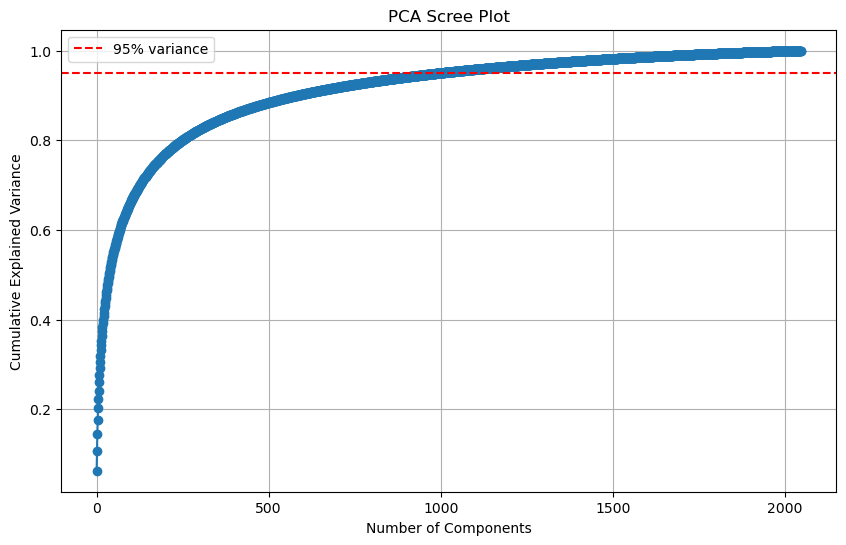

✅ PCA: 996 components retain ≥95% variance


In [16]:
# Step 1: Fit PCA without reducing yet, to inspect variance
pca_full = PCA()
pca_full.fit(features)

# Step 2: Cumulative explained variance
cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)

# Step 3: Plot scree curve
plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance, marker='o')
plt.axhline(y=0.95, color='r', linestyle='--', label='95% variance')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('PCA Scree Plot')
plt.grid(True)
plt.legend()
plt.show()

# Step 4: Select number of components that reach 95% variance
n_components_95 = np.argmax(cumulative_variance >= 0.95) + 1
print(f"✅ PCA: {n_components_95} components retain ≥95% variance")

# Step 5: Fit PCA with this number of components
pca = PCA(n_components=n_components_95)
features_pca = pca.fit_transform(features)


#### Dimensionality Reduction, Clustering, and Visualization Pipeline

This section implements the unsupervised learning and visualization pipeline. It includes the following steps:

1. UMAP + HDBSCAN Embedding
We use UMAP for nonlinear dimensionality reduction of high-dimensional image features into 3D space, optimizing neighborhood and distance parameters. HDBSCAN then clusters the resulting embeddings, allowing discovery of natural groupings in the data with noise filtering.

2. Clustering Evaluation via Silhouette Score
A silhouette score is used to quantify clustering quality, ignoring noise points. This allows us to systematically tune parameters for the best embedding and cluster separation.

3. Grid Search Optimization
Multiple configurations of UMAP parameters are tested to identify the best combination for stable and meaningful clustering. The best result is cached to avoid recomputation.

4. Interactive 3D Visualization with Image Hover
Using Plotly, we generate two visualizations:

- A 3D scatter plot with embedded images shown on hover, allowing intuitive exploration.

- A cluster-colored 3D scatter plot for understanding high-level grouping structure.

5. Base64 Encoding for Hover Thumbnails
Each artwork is encoded to Base64 and embedded directly in the plot’s hover tooltips for a seamless experience.

In [17]:
def run_umap_hdbscan(features, n_neighbors=15, min_dist=0.1, n_components=3,
                     min_cluster_size=50, min_samples=10):
    """
    Applies UMAP for dimensionality reduction followed by HDBSCAN for clustering.

    Parameters:
        features (ndarray): High-dimensional input feature matrix (e.g., from a neural network).
        n_neighbors (int): Number of neighbors to consider in UMAP (controls local/global structure balance).
        min_dist (float): Minimum distance between points in UMAP projection (controls clustering tightness).
        n_components (int): Number of dimensions to reduce to (typically 2 or 3 for visualization).
        min_cluster_size (int): Minimum size of clusters for HDBSCAN (affects granularity of clustering).
        min_samples (int): Minimum samples in a neighborhood for a point to be considered a core point in HDBSCAN.

    Returns:
        embedding (ndarray): UMAP-reduced low-dimensional representation of the input features.
        labels (ndarray): Cluster labels assigned by HDBSCAN (-1 indicates noise).
    """
    import umap, hdbscan
    # Initialize UMAP reducer with specified parameters
    reducer = umap.UMAP(
        n_components=n_components,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        metric='cosine',
        random_state=42,
        low_memory=True,
        verbose=True 
    )
    # Apply UMAP to reduce dimensionality of the feature matrix
    embedding = reducer.fit_transform(features)

    # Initialize HDBSCAN clusterer with specified parameters
    clusterer = hdbscan.HDBSCAN(
        min_cluster_size=min_cluster_size,
        min_samples=min_samples,
        metric='euclidean'
    )
    # Fit HDBSCAN on the UMAP-reduced data and generate cluster labels
    labels = clusterer.fit_predict(embedding)
    # Return the low-dimensional embedding and the corresponding cluster labels
    return embedding, labels

In [18]:
def evaluate_clustering(embedding, labels):
    """
    Evaluates the quality of clustering using the Silhouette Score,
    excluding noise points (label == -1).

    Parameters:
        embedding (ndarray): Low-dimensional data representation (e.g., from UMAP).
        labels (ndarray): Cluster labels assigned to each point (-1 indicates noise).

    Returns:
        float: Silhouette Score for the valid (non-noise) clusters.
               Returns -1 if there are fewer than 2 valid clusters or too few valid points.
    """
    # Create a mask to exclude noise points (labeled as -1 by HDBSCAN)
    valid = labels != -1  # exclude noise
    # If fewer than 2 valid points or fewer than 2 clusters, return an invalid score
    if valid.sum() < 2 or len(set(labels[valid])) < 2:
        return -1  # invalid score
    # Compute and return the Silhouette Score for the valid points
    return silhouette_score(embedding[valid], labels[valid])

In [19]:
param_grid = {
    "n_neighbors": [5, 10, 15],
    "min_dist": [0.01, 0.05, 0.1]
}

def grid_search(grid):
    """
    Performs a manual grid search over UMAP hyperparameters to optimize clustering quality.

    Parameters:
        grid (dict): Dictionary defining the hyperparameter space.
                     Keys are parameter names, values are lists of possible values.

    Returns:
        best_config (dict): Best parameter configuration found.
        best_score (float): Highest Silhouette Score achieved.
        best_emb (ndarray): UMAP embedding corresponding to the best configuration.
        best_labels (ndarray): HDBSCAN labels for the best configuration.
    """
    from itertools import product
    # Extract parameter names and all possible combinations of their values
    keys = list(grid.keys())
    values = list(product(*grid.values()))

    # Initialize variables to track the best results
    best_score = -1
    best_config = None
    best_emb = None
    best_labels = None

    # Loop over each combination of parameters
    for combo in values:
        # Convert current combination into a parameter dictionary
        params = dict(zip(keys, combo))
        # Run UMAP and HDBSCAN clustering using the current parameters
        emb, labels = run_umap_hdbscan(features_pca, **params)
        # Evaluate clustering performance using Silhouette Score
        score = evaluate_clustering(emb, labels)
        # Print current configuration and its score
        print(f"{params}, score={score}")
        # Update best results if the current score is higher
        if score > best_score:
            best_score = score
            best_config = params
            best_emb = emb
            best_labels = labels
    # Return the best configuration and associated results
    return best_config, best_score, best_emb, best_labels

In [20]:
# Define file paths for storing/loading best results
EMB_PATH = "best_embedding.pkl"
LABELS_PATH = "best_labels.pkl"
PARAMS_PATH = "best_params.pkl"
SCORE_PATH = "best_score.pkl"

# Check if all result files already exist to avoid recomputation
if all(os.path.exists(p) for p in [EMB_PATH, LABELS_PATH, PARAMS_PATH, SCORE_PATH]):
    print("✅ Loaded best config and results from disk.")
    # Load previously saved best UMAP embedding
    with open(EMB_PATH, "rb") as f:
        best_emb = pickle.load(f)
    # Load best HDBSCAN cluster labels
    with open(LABELS_PATH, "rb") as f:
        best_labels = pickle.load(f)
    # Load best parameter configuration
    with open(PARAMS_PATH, "rb") as f:
        best_params = pickle.load(f)
    # Load best Silhouette Score
    with open(SCORE_PATH, "rb") as f:
        best_score = pickle.load(f)
else:
    # Run the grid search to find the best UMAP-HDBSCAN configuration
    best_params, best_score, best_emb, best_labels = grid_search(param_grid)
    print("🔍 Best config:", best_params, "with silhouette score:", best_score)

    # Save the best UMAP embedding to disk
    with open(EMB_PATH, "wb") as f:
        pickle.dump(best_emb, f)
    # Save the best HDBSCAN labels
    with open(LABELS_PATH, "wb") as f:
        pickle.dump(best_labels, f)
    # Save the best parameter configuration
    with open(PARAMS_PATH, "wb") as f:
        pickle.dump(best_params, f)
    # Save the best clustering score
    with open(SCORE_PATH, "wb") as f:
        pickle.dump(best_score, f)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.01, n_components=3, n_jobs=1, n_neighbors=5, random_state=42, verbose=True)
Thu May 15 17:46:00 2025 Construct fuzzy simplicial set
Thu May 15 17:46:00 2025 Finding Nearest Neighbors
Thu May 15 17:46:00 2025 Building RP forest with 22 trees
Thu May 15 17:46:15 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Thu May 15 17:46:27 2025 Finished Nearest Neighbor Search
Thu May 15 17:46:29 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 17:47:56 2025 Finished embedding
{'n_neighbors': 5, 'min_dist': 0.01}, score=0.1042565330862999
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.05, n_components=3, n_jobs=1, n_neighbors=5, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 17:48:42 2025 Construct fuzzy simplicial set
Thu May 15 17:48:42 2025 Finding Nearest Neighbors
Thu May 15 17:48:42 2025 Building RP forest with 22 trees
Thu May 15 17:48:51 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Thu May 15 17:48:56 2025 Finished Nearest Neighbor Search
Thu May 15 17:48:56 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 17:50:23 2025 Finished embedding
{'n_neighbors': 5, 'min_dist': 0.05}, score=0.3986356556415558
UMAP(angular_rp_forest=True, metric='cosine', n_components=3, n_jobs=1, n_neighbors=5, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 17:50:49 2025 Construct fuzzy simplicial set
Thu May 15 17:50:49 2025 Finding Nearest Neighbors
Thu May 15 17:50:49 2025 Building RP forest with 22 trees
Thu May 15 17:50:59 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Thu May 15 17:51:04 2025 Finished Nearest Neighbor Search
Thu May 15 17:51:04 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 17:52:31 2025 Finished embedding
{'n_neighbors': 5, 'min_dist': 0.1}, score=0.10041595250368118
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.01, n_components=3, n_jobs=1, n_neighbors=10, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 17:53:00 2025 Construct fuzzy simplicial set
Thu May 15 17:53:00 2025 Finding Nearest Neighbors
Thu May 15 17:53:00 2025 Building RP forest with 22 trees
Thu May 15 17:53:10 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	 7  /  17
	Stopping threshold met -- exiting after 7 iterations
Thu May 15 17:53:20 2025 Finished Nearest Neighbor Search
Thu May 15 17:53:21 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 17:55:03 2025 Finished embedding
{'n_neighbors': 10, 'min_dist': 0.01}, score=0.4274563193321228
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.05, n_components=3, n_jobs=1, n_neighbors=10, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 17:55:24 2025 Construct fuzzy simplicial set
Thu May 15 17:55:25 2025 Finding Nearest Neighbors
Thu May 15 17:55:25 2025 Building RP forest with 22 trees
Thu May 15 17:55:34 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	 7  /  17
	Stopping threshold met -- exiting after 7 iterations
Thu May 15 17:55:45 2025 Finished Nearest Neighbor Search
Thu May 15 17:55:45 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 17:57:27 2025 Finished embedding
{'n_neighbors': 10, 'min_dist': 0.05}, score=-0.35183531045913696
UMAP(angular_rp_forest=True, metric='cosine', n_components=3, n_jobs=1, n_neighbors=10, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 17:59:41 2025 Construct fuzzy simplicial set
Thu May 15 17:59:41 2025 Finding Nearest Neighbors
Thu May 15 17:59:41 2025 Building RP forest with 22 trees
Thu May 15 17:59:50 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	 7  /  17
	Stopping threshold met -- exiting after 7 iterations
Thu May 15 18:00:01 2025 Finished Nearest Neighbor Search
Thu May 15 18:00:02 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 18:01:44 2025 Finished embedding
{'n_neighbors': 10, 'min_dist': 0.1}, score=-0.18336471915245056
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.01, n_components=3, n_jobs=1, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 18:03:57 2025 Construct fuzzy simplicial set
Thu May 15 18:03:58 2025 Finding Nearest Neighbors
Thu May 15 18:03:58 2025 Building RP forest with 22 trees
Thu May 15 18:04:08 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Thu May 15 18:04:26 2025 Finished Nearest Neighbor Search
Thu May 15 18:04:26 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 18:06:28 2025 Finished embedding
{'n_neighbors': 15, 'min_dist': 0.01}, score=0.4177630543708801
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.05, n_components=3, n_jobs=1, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 18:06:47 2025 Construct fuzzy simplicial set
Thu May 15 18:06:47 2025 Finding Nearest Neighbors
Thu May 15 18:06:47 2025 Building RP forest with 22 trees
Thu May 15 18:06:56 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Thu May 15 18:07:14 2025 Finished Nearest Neighbor Search
Thu May 15 18:07:14 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 18:09:16 2025 Finished embedding
{'n_neighbors': 15, 'min_dist': 0.05}, score=-0.17295952141284943
UMAP(angular_rp_forest=True, metric='cosine', n_components=3, n_jobs=1, random_state=42, verbose=True)


/home/ndhiman/.local/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Thu May 15 18:11:29 2025 Construct fuzzy simplicial set
Thu May 15 18:11:29 2025 Finding Nearest Neighbors
Thu May 15 18:11:30 2025 Building RP forest with 22 trees
Thu May 15 18:11:38 2025 NN descent for 17 iterations
	 1  /  17
	 2  /  17
	 3  /  17
	 4  /  17
	 5  /  17
	 6  /  17
	Stopping threshold met -- exiting after 6 iterations
Thu May 15 18:11:56 2025 Finished Nearest Neighbor Search
Thu May 15 18:11:57 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Thu May 15 18:13:58 2025 Finished embedding
{'n_neighbors': 15, 'min_dist': 0.1}, score=0.1384359449148178
🔍 Best config: {'n_neighbors': 10, 'min_dist': 0.01} with silhouette score: 0.42745632


In [21]:
# Convert image files to base64-encoded HTML <img> tags for embedding in hover tooltips
def encode_image(image_path):
    try:
        # Open and resize the image for faster encoding and smaller size
        img = Image.open(image_path).resize((64, 64))
        buffered = BytesIO()
        img.save(buffered, format="PNG")
        img_b64 = base64.b64encode(buffered.getvalue()).decode()
        return f'<img src="data:image/png;base64,{img_b64}">'
    except:
        # Fallback if image file is missing or corrupt
        return "Image not found"

# Inform the user about the ongoing image encoding process
print("🔄 Encoding images for hover display...")
# Use tqdm to display a progress bar while encoding all images
encoded_images = [encode_image(p) for p in tqdm(all_image_paths)]

# Build a DataFrame with UMAP 3D coordinates and corresponding image HTML
df = pd.DataFrame(best_emb, columns=["x", "y", "z"])
df["image"] = encoded_images # Add image column for hover content

# Create a 3D scatter plot using Plotly
fig = px.scatter_3d(
    df,
    x="x", y="y", z="z",
    hover_data={"image": True},
    custom_data=["image"],
    opacity=0.7
)

# Customize the hover tooltip to show coordinates and the image preview
fig.update_traces(
    hovertemplate="<br>".join([
        "X: %{x}",
        "Y: %{y}",
        "Z: %{z}",
        "%{customdata[0]}"
    ])
)
# Set the plot title and display the 3D scatter plot
fig.update_layout(title="3D UMAP Projection with Image Hover")
fig.show()

🔄 Encoding images for hover display...


 18%|█████████████████████████████▌                                                                                                                                      | 20099/111668 [08:59<43:28, 35.11it/s]/opt/calstatela/mambaforge/lib/python3.10/site-packages/PIL/Image.py:3157: DecompressionBombWarning: Image size (96714256 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
 20%|███████████████████████████████▉                                                                                                                                  | 22053/111668 [09:55<1:28:22, 16.90it/s]/opt/calstatela/mambaforge/lib/python3.10/site-packages/PIL/TiffImagePlugin.py:866: UserWarning: Corrupt EXIF data.  Expecting to read 2 bytes but only got 0. 
  warnings.warn(str(msg))
 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 81335/

In [22]:
df.head()

,x,y,z,image
0,6.496480,7.974315,5.215475,"<img src=""data:image/png;base64,iVBORw0KGgoAAA..."
1,8.348589,3.916183,5.749816,"<img src=""data:image/png;base64,iVBORw0KGgoAAA..."
2,5.579779,1.497954,6.692566,"<img src=""data:image/png;base64,iVBORw0KGgoAAA..."
3,8.840846,2.891974,5.814489,"<img src=""data:image/png;base64,iVBORw0KGgoAAA..."
4,3.532634,1.889112,7.176303,"<img src=""data:image/png;base64,iVBORw0KGgoAAA..."


In [23]:
# Ensure thumbnail directory exists to store extracted images
os.makedirs("thumbnails", exist_ok=True)

# Function to decode and save image from a base64 HTML <img> tag
def save_image_from_html(img_tag, index):
    try:
        # Extract base64-encoded image data using regex
        match = re.search(r'base64,(.*)"', img_tag)
        if not match:
            return None
        base64_data = match.group(1)
        img_data = base64.b64decode(base64_data)
        img = Image.open(io.BytesIO(img_data)).convert("RGB")
        # Save the decoded image to disk
        path = f"thumbnails/img_{index}.jpg"
        img.save(path)
        return path
    except Exception as e:
        # Handle any decoding or saving errors gracefully
        print(f"Skipped index {index}: {e}")
        return None

# OPTIONAL: downsample the DataFrame for quicker visualization (useful for large datasets)
# df = df.sample(n=1000, random_state=42).reset_index(drop=True)

# Decode and save all images from HTML to local thumbnail files
thumbnail_paths = [save_image_from_html(img, i) for i, img in enumerate(df["image"])]
# Store thumbnail paths in the DataFrame
df["thumbnail_path"] = thumbnail_paths
# Filter out rows with failed image decoding (i.e., None paths)
df = df[df["thumbnail_path"].notnull()].reset_index(drop=True)

# Prepare HTML hover content using local thumbnail image paths
df["hover"] = df["thumbnail_path"].apply(lambda p: f'<img src="{p}" width="150">')

# Create a 3D scatter plot with Plotly using go.Scatter3d
fig = go.Figure(data=[go.Scatter3d(
    x=df["x"],
    y=df["y"],
    z=df["z"],
    mode='markers',
    marker=dict(size=3, opacity=0.7),
    hoverinfo='text',
    hovertext=df["hover"]
)])
# Customize layout with axis labels and size
fig.update_layout(
    title='3D Visualization with Image Hover',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    ),
    width=900,
    height=700,
    showlegend=False
)
# Display the interactive 3D plot
fig.show()

Skipped index 35931: Decompressed Data Too Large
Skipped index 71626: Decompressed Data Too Large


In [24]:
# Export as records (list of dicts, ideal for structured data)
df.to_json("embedding_with_images.json", orient="records", indent=2)

In [25]:
# Example input: replace with your actual arrays
# embedding_3d: shape (n_samples, 3)
# best_labels: array of cluster labels, -1 for noise

# Construct DataFrame
df = pd.DataFrame(best_emb, columns=["x", "y", "z"])
df["label"] = best_labels

# Convert -1 (noise) to string to distinguish it in the plot
df["label_str"] = df["label"].apply(lambda l: "Noise" if l == -1 else f"Cluster {l}")

# Plot with Plotly Express
fig = px.scatter_3d(
    df,
    x="x", y="y", z="z",
    color="label_str",
    title="3D HDBSCAN Cluster Visualization",
    labels={"label_str": "Cluster"},
    opacity=0.7
)

fig.update_traces(marker=dict(size=3))
fig.update_layout(legend_title_text="Cluster Label", width=900, height=700)

fig.show()
